In [1]:
# !usr/bin/env python
# -*- coding:utf-8 _*-

import json
import collections
import argparse
import numpy as np
import pickle
from huffman import codebook as hcode
from tqdm import tqdm
import scipy.io
############
import tensorflow as tf
import matplotlib.pyplot as plt   
import os
import sys 
sys.path.append("..") 

from utlis.tools import SeqtoText, BleuScore, SNR_to_noise, Similarity
from dataset.dataloader import return_loader
from parameters import para_config
from models.modules import create_masks, loss_function, create_look_ahead_mask, create_padding_mask
from models.transceiver import Transeiver, Mine,Transeiver_GAN,Transeiver_DCGAN
from utlis.trainer import train_step, train_attack_step,eval_step_normal,eval_step_FGM
from utlis.gan_train import gan_train_step,eval_step

if __name__=='__main__':
    # Set random seed
    tf.random.set_seed(5)
    # choose performance metrics
    test_metrics = True
    test_bleu = True
    test_sentence_sim = False
    test_mi = False
    runs = 10
    SNR = [6]
    # Set Parameters
    args = para_config()
    # Load the vocab（词汇表）
    vocab = json.load(open(args.vocab_path, 'rb'))#vocab是只有一个字典token_to_idx的字典，token_to_idx有两万多个词汇
    args.vocab_size = len(vocab['token_to_idx'])
    token_to_idx = vocab['token_to_idx']
    args.pad_idx = token_to_idx["<PAD>"]
    args.start_idx = token_to_idx["<START>"]
    args.end_idx = token_to_idx["<END>"]#取得令牌后对应的数据
    StoT = SeqtoText(token_to_idx, args.end_idx)

Using TensorFlow backend.


In [2]:
parser = argparse.ArgumentParser()
parser.add_argument('--encoding', default=True,action='store_true', help='enable the encoding')
parser.add_argument('--decoding', default=False,action='store_true', help='enable the decoding')
parser.add_argument('--data-dir', default='F:/jupyter/semantic/Attack-DeepSC/common/data/data.json', type=str, help='The PATH to LOAD sentences')
parser.add_argument('--decoded-text', default='F:/jupyter/semantic/Attack-DeepSC/common/decoded-text', type=str, help='The PATH to LOAD the received bits')
parser.add_argument('--output-dir', default='F:/jupyter/semantic/Attack-DeepSC/common/output', type=str, help='The PATH to store the recovered sentences')


class Huffman():
    def __init__(self, data, num_lines_read=50000):
        char_count = collections.Counter()#collections.Counter对列表中的元素进行计算，并返回一个字典['a','a','b']->Counter({'a': 2, 'b': 1})
        print('initializing huffman codebook')
        for line in tqdm(data):
            for char in line:
                char_count.update(char)#Counter().update函数将两个counter对象中的元素相加，合并成一个新的counter对象
        self.huffman_code = hcode(char_count.items())
        self.huffman_decode = dict(zip(self.huffman_code.values(), self.huffman_code.keys()))#huffman_decode是字典，解码时输入每个字符对应的str就能解码了
        print(self.huffman_decode)

    def encode(self, word):
        """ Returns binary string sequence"""
        encoding = ''.join(self.huffman_code.get(x) for x in word)
        return encoding

    def decode(self, binary):
        """ Decode the binary to string """
        decoding = ""
        while binary:
            for k in self.huffman_decode:
                if binary.startswith(k):
                    decoding += self.huffman_decode[k]
                    binary = binary[len(k):]
        return decoding

def source_encoding(sentences):
    # Encoding
    #将句子中的每个字母取出来（包含空格），然后将每个字母用huffman码表示
    h_encoding,h_sentence,a = [],[],[]
    for line in tqdm(sentences):
        for word in line:
            a.append(huffman.encode(word))
            h_encoding.append(huffman.encode(word))
            
        #计算每句话的长度
        sentence_len = len(a)
        h_sentence.append(sentence_len)
        a = []
        
    # record the length bits
    h_bit_length = [len(bit) for bit in h_encoding ]#计算每个单词的长度（bit）
    h_bit_length = np.array(h_bit_length)#形成一个词长度的列表

    return h_bit_length, h_encoding,h_sentence

def source_decoding(args, snr, received,h_sentence,
                    huffman_bit_length, huffman_encoding):
    #接收的数据是纯bit，需要知道每个字母的比特长度（huffman_bit_length），才能处理数据
    huffman_received = []
    a = 0
    for length in huffman_bit_length:
        b = a + length
        huffman_received.append(received[a:b])
        a = b
        
    huffman_received_str = []
    #将列表形式转字符串
    for i in range(len(huffman_received)):
        string = ''
        for i in huffman_received[i]:
            string = string+str(i)
        huffman_received_str.append(string)
    #是否正确的列表
    logic_huffman = [(huffman_received_str[x] == huffman_encoding[x]) for x in range(len(huffman_received))]
    
    predicted_words = []
    for x, line in enumerate(huffman_received_str):
        if not logic_huffman[x]:
            predicted_words.append('*')
        #  estimated_sentence_huffman.append(line)
        else:
            word = huffman.decode(line)
            predicted_words.append(word)
    
    j = 0
    predicted_sentences = []
    for length in h_sentence:
        # combine as a sentence
        a = ''.join(predicted_words[j: j + length])
        predicted_sentences.append(a)
        j += length
    
    return logic_huffman,huffman_received_str,predicted_words,predicted_sentences




In [3]:
if __name__ == '__main__':
    args = parser.parse_known_args()[0]
    with open('F:/jupyter/semantic/Attack-DeepSC/common/data/data.pkl', 'rb') as f:
        seqs = pickle.load(f)# 加载数据
        print(len(seqs))
    huffman = Huffman(data=seqs)  # Initialize the huffman dictionaryseqs

1000
initializing huffman codebook


100%|███████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 13612.48it/s]

{'1101': 't', '11000': 'h', '001': 'e', '111': ' ', '1011': 'o', '00010': 'u', '0100': 's', '0101': 'r', '0111': 'a', '1000': 'n', '00011': 'd', '1100111': 'b', '1100100': 'v', '01101': 'm', '1010': 'i', '10011': 'l', '01100': 'c', '000011': 'w', '00000': 'p', '000010': 'y', '1100101': '.', '11001100': 'k', '100100': 'g', '1100110101': 'q', '100101': 'f', '1100110110': 'j', '110011010011': '?', '11001101000': 'z', '1100110111': 'x', '110011010010': '!'}


In [4]:
if test_mi:
    # learning rate
    optim_mi = tf.keras.optimizers.Adam(lr=0.001)
    for snr in SNR:
        n_std = SNR_to_noise(snr)
        for (batch, (inp, tar)) in enumerate(test_dataset):
            loss_mine = train_mine_step(inp, tar, net, mine_net, optim_mi, args.channel, n_std)
        print("SNR %f loss mine %f" % (snr, loss_mine.numpy()))

if test_metrics:
    if test_sentence_sim:
        metrics = Similarity(args.bert_config_path, args.bert_checkpoint_path, args.bert_dict_path)
    elif test_bleu:
        metrics = BleuScore(1, 0, 0, 0)
    else:
        raise Exception('Must choose bleu score or sentence similarity')
        
    # Start the evaluation
    # for snr in SNR:


In [5]:
if args.encoding:
    huffman_bit_length, huffman_encoding,h_sentence = source_encoding(seqs)


100%|████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 9440.85it/s]


In [8]:
#解PNR=30dB时的Turbo+FGM

list = []
os.remove('F:/jupyter/semantic/Attack-DeepSC/common/log/Turbo+FGM.pkl')
SNR = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]
for snr in tqdm(SNR):
    #读取信道解码后的数据
    adress1 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo-FGM/Turbo-SNR='+str(snr)+'.mat'
    #adress2 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/RS/RS-SNR='+str(snr)+'.mat'
    adress2= 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo/Turbo-SNR='+str(snr)+'.mat'
    received_Turbo = scipy.io.loadmat(adress1)
    received_Turbo = received_Turbo['msgOutBits'].tolist()
    received_RS = scipy.io.loadmat(adress2)
    received_RS = received_RS['msgOutBits'].tolist()
    ##将received调整成huffman_encoding的格式
    received_Turbo = [i for item in received_Turbo for i in item]
    received_RS = [i for item in received_RS for i in item]
    
    _,_,Tpredicted_words,Tpredicted_sentences = source_decoding(args, snr, received_Turbo, h_sentence, huffman_bit_length, huffman_encoding)
    _,_,Rpredicted_words,Rpredicted_sentences = source_decoding(args, snr, received_RS, h_sentence, huffman_bit_length, huffman_encoding)
    #print(predicted_words)
    target_word=seqs
    word=Tpredicted_sentences
    word2=Rpredicted_sentences
    score1 = metrics.compute_score(word, target_word)
    score2 = metrics.compute_score(word2, target_word)
    print('snr=',snr)
    print(sum(score1)/len(score1))
    print(sum(score2)/len(score2))
    list.append([snr,sum(score1)/len(score1),sum(score2)/len(score2)])


with open('F:/jupyter/semantic/Attack-DeepSC/common/log/Turbo+FGM.pkl', 'wb') as f:
    pickle.dump(list, f)

  5%|████▎                                                                              | 1/19 [00:01<00:22,  1.23s/it]

snr= 0
0.00029896686159844055
0.0828097114478932


 11%|████████▋                                                                          | 2/19 [00:02<00:22,  1.34s/it]

snr= 1
0.0003584656084656085
0.11349917943958945


 16%|█████████████                                                                      | 3/19 [00:03<00:21,  1.33s/it]

snr= 2
0.00039621693121693116
0.1339332414350907


 21%|█████████████████▍                                                                 | 4/19 [00:05<00:19,  1.31s/it]

snr= 3
0.0005057672776713024
0.1745637240191053


 26%|█████████████████████▊                                                             | 5/19 [00:06<00:18,  1.35s/it]

snr= 4
0.0006529623726885391
0.2063329763541378


 32%|██████████████████████████▏                                                        | 6/19 [00:08<00:17,  1.35s/it]

snr= 5
0.00035371497257906994
0.2553989628390065


 37%|██████████████████████████████▌                                                    | 7/19 [00:09<00:16,  1.33s/it]

snr= 6
0.001104108824562545
0.2983125003846429


 42%|██████████████████████████████████▉                                                | 8/19 [00:10<00:15,  1.37s/it]

snr= 7
0.0018905649096088945
0.35250367230033774


 47%|███████████████████████████████████████▎                                           | 9/19 [00:12<00:13,  1.37s/it]

snr= 8
0.0020447840916502187
0.41626417589251563


 53%|███████████████████████████████████████████▏                                      | 10/19 [00:13<00:12,  1.36s/it]

snr= 9
0.0024466621705716406
0.4862783565835583


 58%|███████████████████████████████████████████████▍                                  | 11/19 [00:14<00:11,  1.41s/it]

snr= 10
0.003584705238614707
0.5630525304066443


 63%|███████████████████████████████████████████████████▊                              | 12/19 [00:16<00:09,  1.42s/it]

snr= 11
0.005343676008252644
0.6356788193581828


 68%|████████████████████████████████████████████████████████                          | 13/19 [00:17<00:08,  1.40s/it]

snr= 12
0.006393789424722417
0.7326564287403091


 74%|████████████████████████████████████████████████████████████▍                     | 14/19 [00:19<00:07,  1.44s/it]

snr= 13
0.009452633281208649
0.8057832864228188


 79%|████████████████████████████████████████████████████████████████▋                 | 15/19 [00:20<00:05,  1.45s/it]

snr= 14
0.013065581360288408
0.884223494692473


 84%|█████████████████████████████████████████████████████████████████████             | 16/19 [00:22<00:04,  1.43s/it]

snr= 15
0.0164620656345427
0.9339978956814914


 89%|█████████████████████████████████████████████████████████████████████████▎        | 17/19 [00:23<00:03,  1.52s/it]

snr= 16
0.022994047806540654
0.969662583778715


 95%|█████████████████████████████████████████████████████████████████████████████▋    | 18/19 [00:25<00:01,  1.53s/it]

snr= 17
0.03104317650034685
0.9866023064760533


100%|██████████████████████████████████████████████████████████████████████████████████| 19/19 [00:26<00:00,  1.41s/it]

snr= 18
0.03961698305197921
0.9954019029461162


In [12]:
#这是信源解码，等信道解码了以后再用
list = []
os.remove('F:/jupyter/semantic/Attack-DeepSC/common/log/log.pkl')
SNR = [0,3,6,9,12,15,18]
for snr in tqdm(SNR):
    #读取信道解码后的数据
    adress1 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo-FGM/Turbo-SNR='+str(snr)+'.mat'
    #adress2 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/RS/RS-SNR='+str(snr)+'.mat'
    adress2= 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo-FGM/Turbo-SNR='+str(snr)+'.mat'
    received_Turbo = scipy.io.loadmat(adress1)
    received_Turbo = received_Turbo['msgOutBits'].tolist()
    received_RS = scipy.io.loadmat(adress2)
    received_RS = received_RS['msgOutBits'].tolist()
    ##将received调整成huffman_encoding的格式
    received_Turbo = [i for item in received_Turbo for i in item]
    received_RS = [i for item in received_RS for i in item]
    
    _,_,Tpredicted_words,Tpredicted_sentences = source_decoding(args, snr, received_Turbo, h_sentence, huffman_bit_length, huffman_encoding)
    _,_,Rpredicted_words,Rpredicted_sentences = source_decoding(args, snr, received_RS, h_sentence, huffman_bit_length, huffman_encoding)
    #print(predicted_words)
    target_word=seqs
    word=Tpredicted_sentences
    word2=Rpredicted_sentences
    score1 = metrics.compute_score(word, target_word)
    score2 = metrics.compute_score(word2, target_word)
    print('snr=',snr)
    print(sum(score1)/len(score1))
    print(sum(score2)/len(score2))
    list.append([snr,sum(score1)/len(score1),sum(score2)/len(score2)])


with open('F:/jupyter/semantic/Attack-DeepSC/common/log/log.pkl', 'wb') as f:
    pickle.dump(list, f)

 14%|████████████                                                                        | 1/7 [00:01<00:08,  1.44s/it]

snr= 0
0.05696175658049128
0.08097569513704958


 29%|████████████████████████                                                            | 2/7 [00:02<00:07,  1.47s/it]

snr= 3
0.12677572515692592
0.1718360485996264


 43%|████████████████████████████████████                                                | 3/7 [00:04<00:06,  1.51s/it]

snr= 6
0.2382467312071881
0.30166710293876897


 57%|████████████████████████████████████████████████                                    | 4/7 [00:06<00:04,  1.54s/it]

snr= 9
0.40543951133995715
0.4835526380289246


 71%|████████████████████████████████████████████████████████████                        | 5/7 [00:07<00:03,  1.60s/it]

snr= 12
0.6154054796132897
0.7323843588845798


 86%|████████████████████████████████████████████████████████████████████████            | 6/7 [00:09<00:01,  1.62s/it]

snr= 15
0.8527619683780766
0.9329319730328168


100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:11<00:00,  1.58s/it]

snr= 18
0.9804623167358004
0.9958734883884884


In [10]:
with open('F:/jupyter/semantic/Attack-DeepSC/common/log/log.pkl', 'rb') as f:
    a = pickle.load(f)
snr_list=[]
Loss_list=[]
Loss2_list=[]
for i in range(len(a)):
    snr_list.append(a[i][0])
    Loss_list.append(a[i][1])
    Loss2_list.append(a[i][2])

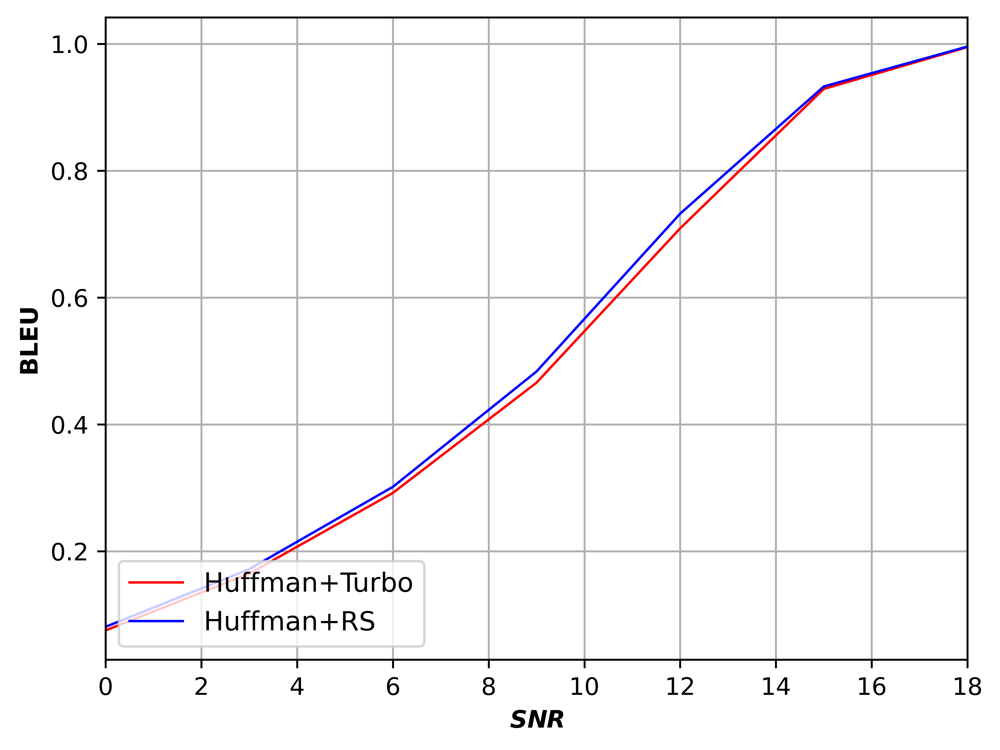

In [11]:

    
#画图
fig, ax = plt.subplots(dpi=800)

ax.plot(snr_list, Loss_list,'r-',linewidth =1,label='Huffman+Turbo')
ax.plot(snr_list, Loss2_list,'b-',linewidth =1,label='Huffman+RS')

#ax.set_yscale('log')
plt.legend(loc='lower left', fontsize=11)
ax.set_xlabel('${SNR}$',fontweight='bold')
ax.set_ylabel('BLEU',fontweight='bold')
plt.xlim([0, 18]) 
ax.grid(True)
plt.rcParams["font.weight"] = "bold"
plt.rcParams['font.family'] = "serif"
plt.rcParams['font.serif'] = "Times New Roman"
plt.rcParams.update({'font.size': 12})


plt.show()


In [27]:
adress1 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo/Turbo-SNR=15.mat'
adress2 = 'F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/RS/RS-SNR=15.mat'
received_Turbo = scipy.io.loadmat(adress1)
received_Turbo = received_Turbo['msgOutBits'].tolist()
received_RS = scipy.io.loadmat(adress2)
received_RS = received_RS['msgOutBits'].tolist()
##将received调整成huffman_encoding的格式
received_Turbo = [i for item in received_Turbo for i in item]
received_RS = [i for item in received_RS for i in item]
snr = 15
x,_,Tpredicted_words,Tpredicted_sentences = source_decoding(args, snr, received_Turbo, h_sentence, huffman_bit_length, huffman_encoding)
_,_,Rpredicted_words,Rpredicted_sentences = source_decoding(args, snr, received_RS, h_sentence, huffman_bit_length, huffman_encoding)
#print(predicted_words)
target_word=seqs
word=Tpredicted_sentences
word2=Rpredicted_sentences
score1 = metrics.compute_score(word, target_word)
score2 = metrics.compute_score(word2, target_word)
print('snr=',snr)
print(sum(score1)/len(score1))
print(sum(score2)/len(score2))

print(Tpredicted_sentences[4])
print(seqs[4])
print(score1[4])

snr= 15
0.5749693333065137
0.19627819257084456
in any event th*s question*is no* pres**tly inclu*ed among *h* requests for*topica* and urgent debat* on thursday*.
in any event this question is not presently included among the requests for topical and urgent debate on thursday .
0.4


In [8]:
#存长度信息(如果解码时查哈夫曼表就太麻烦了，用长度信息是为了省去这一步骤)
with open(args.decoded_text+'/huffman_word_length.pkl', 'wb') as f:
    pickle.dump(huffman_bit_length, f)
#存比特信息
whole_string = "".join(huffman_encoding)
whole_string = [i for i in whole_string]
scipy.io.savemat('./decoded-text/data.mat', {'string': whole_string})

word_per_bit = sum(huffman_bit_length)/len(huffman_bit_length)
print(word_per_bit)  


4.176270549739514


In [7]:

print(huffman_encoding[3:10])
whole_string = "".join(huffman_encoding[3:10])
x=[i for i in whole_string]
print(x)
print(whole_string)

['111', '11000', '1011', '00010', '0100', '001', '111']
['1', '1', '1', '1', '1', '0', '0', '0', '1', '0', '1', '1', '0', '0', '0', '1', '0', '0', '1', '0', '0', '0', '0', '1', '1', '1', '1']
111110001011000100100001111


In [12]:
with open(args.decoded_text+'/huffman_encoding.pkl', 'rb') as f:
    s=pickle.load(f)
    print(s)

[['110111000001', '110001011000100100001', '011010110100001', '0111100001011', '1011110011101000010110110010000101011', '0111', '0001110101000000101101001', '0100', '0100101010011001100001010001'], ['11011100010100100', '10100100', '01111001110011', '10101000', '0111010100101010110110010110111100001010001', '0000101010110111000', '110111000001', '0000001101010100001010101000000100110010100', '11011100001111101', '000010001', '1100001111100100001', '01111001100001001110000110100', '0001000000110000011001101011', '1100101'], ['1101110000111100011001100', '000011101100010', '000110110', '010000110010010001010', '1010', '01001100001111001110011', '010111011', '01001011', '1001001001101110101110011000011', '1100101', '101010000101100100101011', '10101101', '10100100', '11001101010001010101101001', '10101000', '110011000010010000010101000100100', '0000101010110111000', '110111000001', '0000010110100101011011010101110000100', '11011100010100100', '110001011000100100001', '1100001110100', '011

In [14]:
received = scipy.io.loadmat('F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/SNR=18.mat')
received = received['msgOutBits']
received = received.tolist()
received = [i for item in received for i in item]
print(received)
print(len(received))


[1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 

In [4]:

received_Turbo = scipy.io.loadmat('F:/jupyter/semantic/Comm-Benchmarks-master/channel-coding/output/Turbo/Turbo-error-rate.mat')
received_Turbo = received_Turbo['errRate']
print(received_Turbo)

[[0.33993121 0.28170781 0.21573928 0.15454991 0.10477466 0.06923512
  0.04336042 0.02259864 0.0077759 ]]


In [39]:
print( len(received) )

1012
